# YOLO v2
![alt text](https://pjreddie.com/media/image/model2.png)

(The image above is taken from the [official YOLO v2 homepage](https://pjreddie.com/darknet/yolov2/))

This example interactively demonstrates [YOLO v2](https://openaccess.thecvf.com/content_cvpr_2017/papers/Redmon_YOLO9000_Better_Faster_CVPR_2017_paper.pdf), a model for object detection.


# Preparation
Let's first link drive to save the files, load libraries and download the necessary repos.

In [ ]:
# YOLO REPOS
!pip install nnabla-ext-cuda100
# !git clone https://github.com/sony/nnabla-examples.git
!git clone https://github.com/pabloantunamolina/YOLO_and_other_NNLibraries.git
# %run nnabla-examples/interactive-demos/colab_utils.py
%run YOLO_and_other_NNLibraries/interactive-demos/colab_utils.py
# %cd nnabla-examples/object-detection/yolov2
%cd YOLO_and_other_NNLibraries/object-detection/yolov2

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Cloning into 'YOLO_and_other_NNLibraries'...
remote: Enumerating objects: 7559, done.
remote: Counting objects: 100% (67/67), done.
remote: Compressing objects: 100% (53/53), done.
remote: Total 7559 (delta 26), reused 30 (delta 11), pack-reused 7492
Receiving objects: 100% (7559/7559), 292.03 MiB | 24.65 MiB/s, done.
Resolving deltas: 100% (3971/3971), done.
Checking out files: 100% (1537/1537), done.
/content/YOLO_and_other_NNLibraries/object-detection/yolov2/YOLO_and_other_NNLibraries/object-detection/yolov2


In [ ]:
from google.colab import drive

drive.mount('/content.gdrive')

In [ ]:
!pip install tensorflow==1.13.2 opencv-python slim slidingwindow

!apt install swig

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Reading package lists... Done
Building dependency tree       
Reading state information... Done
swig is already the newest version (3.0.12-1).
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'apt autoremove' to remove it.
0 upgraded, 0 newly installed, 0 to remove and 45 not upgraded.


In [ ]:
# YOLO libraries
import os
import PIL
import numpy as np
import PIL.Image
from itertools import islice

Let's also download pre-trained weight parameters and auxiliary file. We will also convert the weight parameters to .h5 format to make it compatible with NNabla. For the OpenPose part let's also download the pre-trained model.

 This may take a few minutes.

In [ ]:
# YOLO
!wget https://pjreddie.com/media/files/yolov2.weights
!wget https://raw.githubusercontent.com/pjreddie/darknet/master/data/coco.names
!python convert_yolov2_weights_to_nnabla.py --input yolov2.weights

--2022-06-09 07:26:29--  https://pjreddie.com/media/files/yolov2.weights
Resolving pjreddie.com (pjreddie.com)... 128.208.4.108
Connecting to pjreddie.com (pjreddie.com)|128.208.4.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 203934260 (194M) [application/octet-stream]
Saving to: ‘yolov2.weights’

yolov2.weights      100%[===================>] 194.49M  21.0MB/s    in 10s     

2022-06-09 07:26:40 (19.4 MB/s) - ‘yolov2.weights’ saved [203934260/203934260]

--2022-06-09 07:26:40--  https://raw.githubusercontent.com/pjreddie/darknet/master/data/coco.names
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.108.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 625 [text/plain]
Saving to: ‘coco.names’

coco.names          100%[===================>]     625  --.-KB/s    in 0s      

2022-0

# Upload Image
Run the following cell to upload your own image.



In [ ]:
from google.colab import files

original_img = files.upload()

Saving Screenshot 2022-06-06 at 18.27.18.png to Screenshot 2022-06-06 at 18.27.18.png
Saving Screenshot 2022-06-06 at 18.28.30.png to Screenshot 2022-06-06 at 18.28.30.png
Saving Screenshot 2022-06-06 at 18.28.39.png to Screenshot 2022-06-06 at 18.28.39.png
Saving Screenshot 2022-06-06 at 18.28.59.png to Screenshot 2022-06-06 at 18.28.59.png
Saving Screenshot 2022-06-06 at 18.29.16.png to Screenshot 2022-06-06 at 18.29.16.png
Saving Screenshot 2022-06-06 at 18.30.51.png to Screenshot 2022-06-06 at 18.30.51.png
Saving Screenshot 2022-06-06 at 18.31.10.png to Screenshot 2022-06-06 at 18.31.10.png
Saving Screenshot 2022-06-06 at 18.31.32.png to Screenshot 2022-06-06 at 18.31.32.png
Saving Screenshot 2022-06-06 at 18.31.41.png to Screenshot 2022-06-06 at 18.31.41.png
Saving Screenshot 2022-06-06 at 18.31.51.png to Screenshot 2022-06-06 at 18.31.51.png
Saving Screenshot 2022-06-06 at 18.32.00.png to Screenshot 2022-06-06 at 18.32.00.png
Saving Screenshot 2022-06-06 at 18.32.46.png to Screen

In [ ]:
img = original_img

Let's rename the image for convenience.



In [ ]:
keys = list(img.keys())
new_keys = []

for i in range(len(keys)):
  ext = os.path.splitext(keys[i])[-1]
  os.rename(keys[i], str(i) + "input_image{}".format(ext)) 
  new_input_img = str(i) + "input_image" + ext
  new_keys.append(new_input_img)
  
  print('image renamed!')

image renamed!
image renamed!
image renamed!
image renamed!
image renamed!
image renamed!
image renamed!
image renamed!
image renamed!
image renamed!
image renamed!
image renamed!
image renamed!
image renamed!


Immediate surroundings are important to fully understand the scenes

In [ ]:
def add_pixels_loweredges(coord_list, pix_num):
  new_list = []
  for i in coord_list:
    i -= pix_num
    new_list.append(i)
  
  return new_list

def add_pixels_upperedges(coord_list, pix_num):
  new_list = []
  for i in coord_list:
    i += pix_num
    new_list.append(i)
  
  return new_list

# Object Detection
Now let's run YOLO v2 to your image and see how it performs object detection!

0input_image.png
Input:


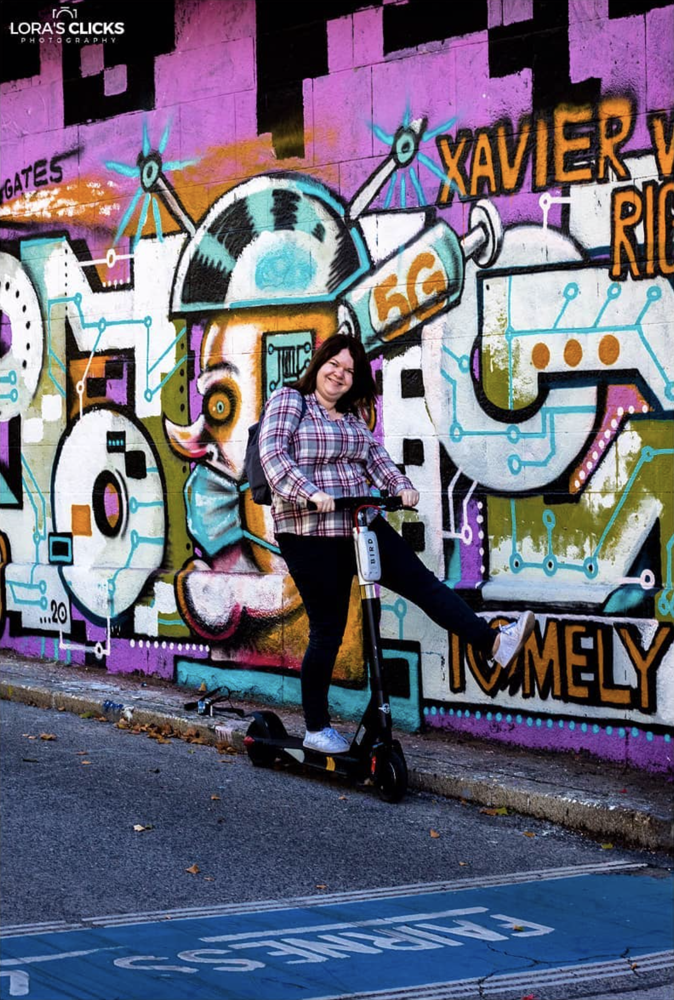

Output:


['2022-06-09 07:45:29,483 [nnabla][INFO]: Initializing CPU extension...', '2022-06-09 07:45:29,880 [nnabla][INFO]: Initializing CUDA extension...', '2022-06-09 07:45:29,898 [nnabla][INFO]: Initializing cuDNN extension...', 'forward', 'done', '[INFO] person: 88.92%', '[[593, 705, 993, 1779], [538, 709, 1134, 1771], [577, 710, 1131, 1802]]', 'Processing time: 19.8 [ms/image]']
[[538, 709, 1134, 1771], [577, 710, 1131, 1802], [593, 705, 993, 1779]]
[[492, 641, 1179.54, 1838], [531, 642, 1176.54, 1869], [547, 637, 1038.54, 1846]]
[[array([492, 531, 547])], [array([641, 642, 637])], [array([1179.54, 1176.54, 1038.54])], [array([1838, 1869, 1846])]]
[[[492, 531, 547]], [[641, 642, 637]], [[1179.54, 1176.54, 1038.54]], [[1838, 1869, 1846]]]


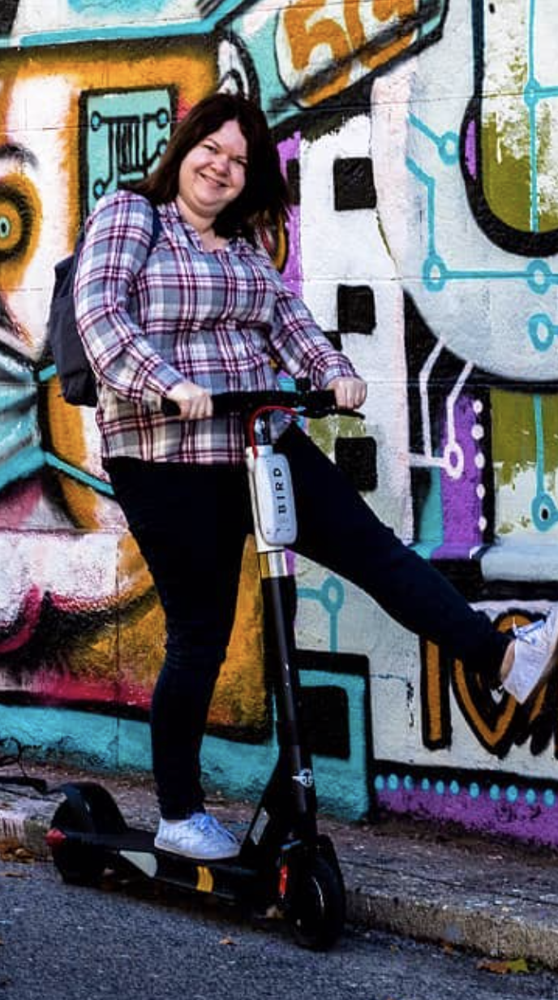

1input_image.png
Input:


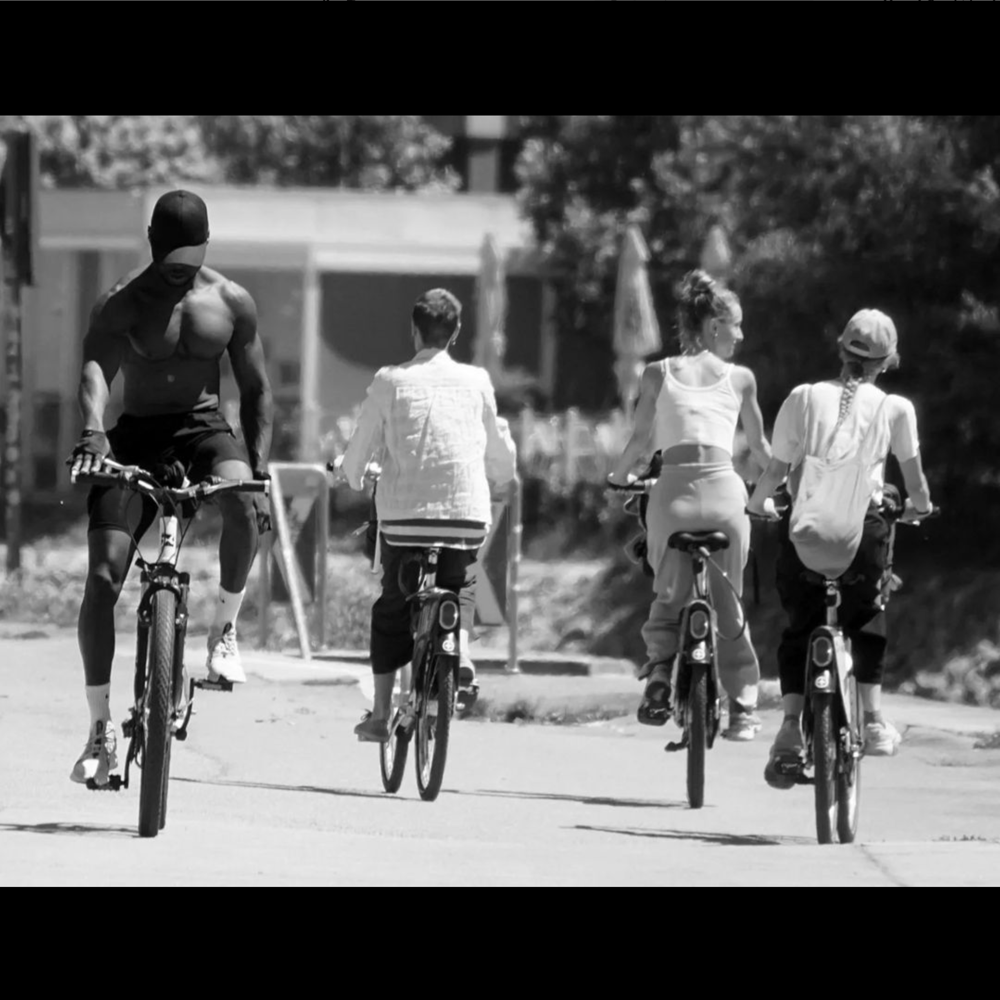

Output:


['2022-06-09 07:45:35,004 [nnabla][INFO]: Initializing CPU extension...', '2022-06-09 07:45:35,565 [nnabla][INFO]: Initializing CUDA extension...', '2022-06-09 07:45:35,589 [nnabla][INFO]: Initializing cuDNN extension...', 'forward', 'done', '[INFO] person: 80.15%', '[INFO] person: 83.75%', '[INFO] person: 80.08%', '[INFO] person: 85.44%', '[INFO] bicycle: 70.15%', '[INFO] bicycle: 79.17%', '[INFO] bicycle: 81.94%', '[INFO] bicycle: 70.26%', '[[633, 1126, 816, 1596], [178, 406, 663, 1877], [165, 413, 683, 1938], [783, 720, 1256, 1816], [827, 715, 1261, 1804], [1473, 736, 1863, 1724], [1495, 705, 1902, 1770], [778, 720, 1243, 1897], [858, 781, 1245, 1853], [1506, 735, 1890, 1904], [1844, 755, 2271, 1939], [1867, 781, 2292, 1900], [1463, 1130, 1852, 1905], [1533, 1120, 1862, 1916], [198, 1186, 547, 2048], [239, 1139, 594, 2076], [920, 1261, 1207, 1976], [1488, 1161, 1842, 1988], [1553, 1211, 1857, 1986], [1860, 1208, 2206, 2075], [1909, 1380, 2169, 2056], [168, 484, 684, 1804], [164, 442

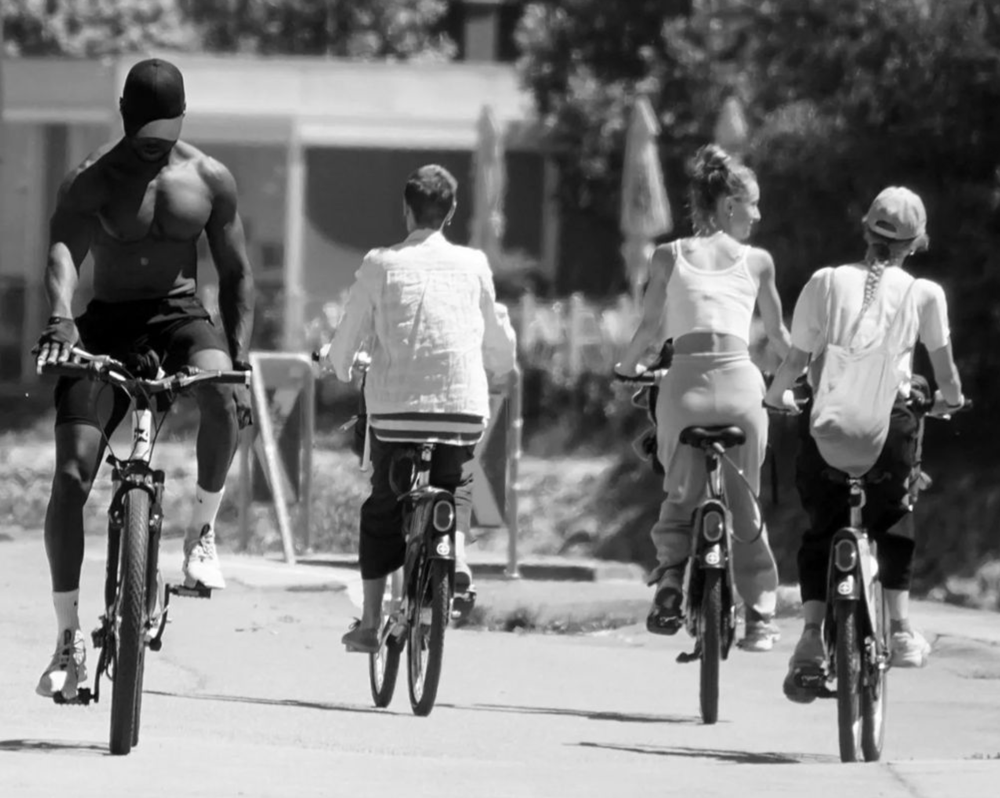

2input_image.png
Input:


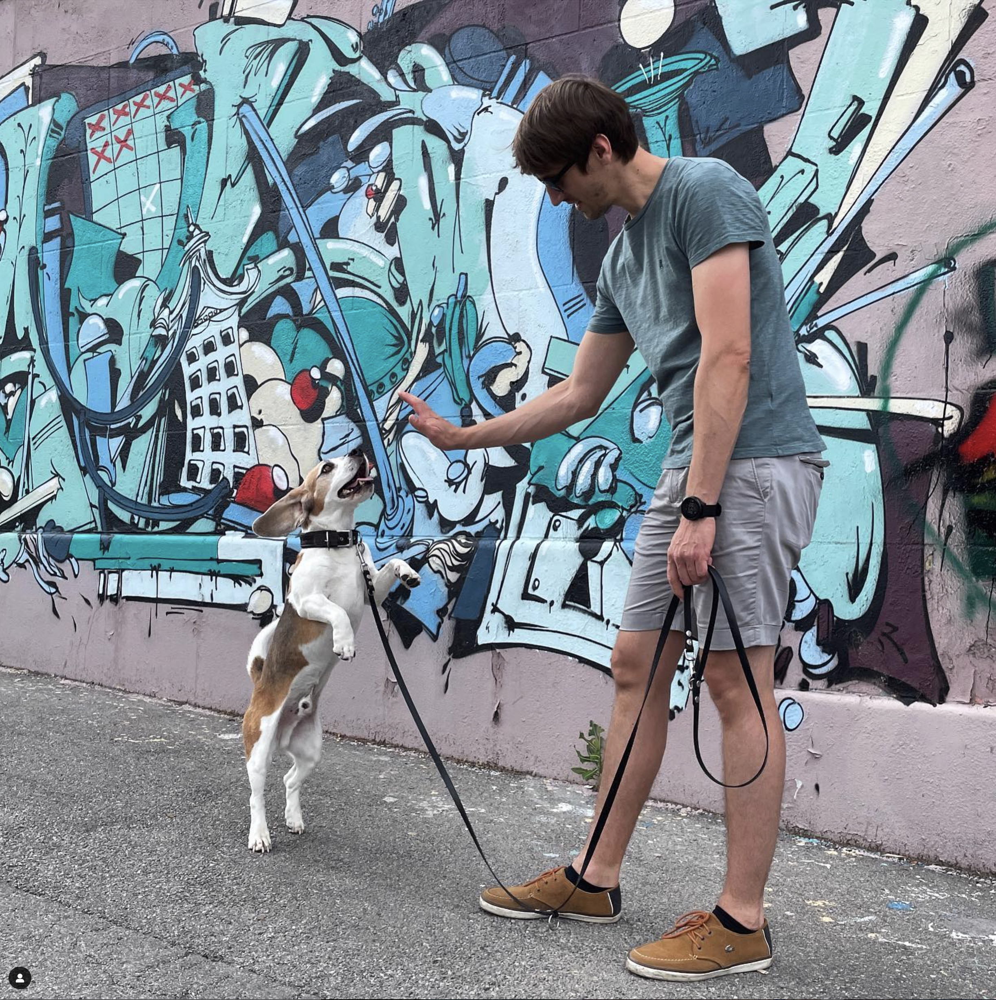

Output:


['2022-06-09 07:45:41,164 [nnabla][INFO]: Initializing CPU extension...', '2022-06-09 07:45:41,733 [nnabla][INFO]: Initializing CUDA extension...', '2022-06-09 07:45:41,762 [nnabla][INFO]: Initializing cuDNN extension...', 'forward', 'done', '[INFO] person: 86.19%', '[[568, 1104, 940, 2101], [933, 144, 2053, 1892], [938, 259, 2058, 1983], [953, 219, 2041, 2242], [1072, 135, 2069, 2350], [977, 253, 2013, 2403], [1090, 214, 2039, 2436]]', 'Processing time: 16.4 [ms/image]']
[[568, 1104, 940, 2101], [933, 144, 2053, 1892], [938, 259, 2058, 1983], [953, 219, 2041, 2242], [977, 253, 2013, 2403], [1072, 135, 2069, 2350], [1090, 214, 2039, 2436]]
[[494, 1030, 1013.38, 2174], [859, 70, 2126.38, 1965], [864, 185, 2131.38, 2056], [879, 145, 2114.38, 2315], [903, 179, 2086.38, 2403], [998, 61, 2142.38, 2423], [1016, 140, 2112.38, 2436]]
[[array([ 494,  859,  864,  879,  903,  998, 1016])], [array([1030,   70,  185,  145,  179,   61,  140])], [array([1013.38, 2126.38, 2131.38, 2114.38, 2086.38, 21

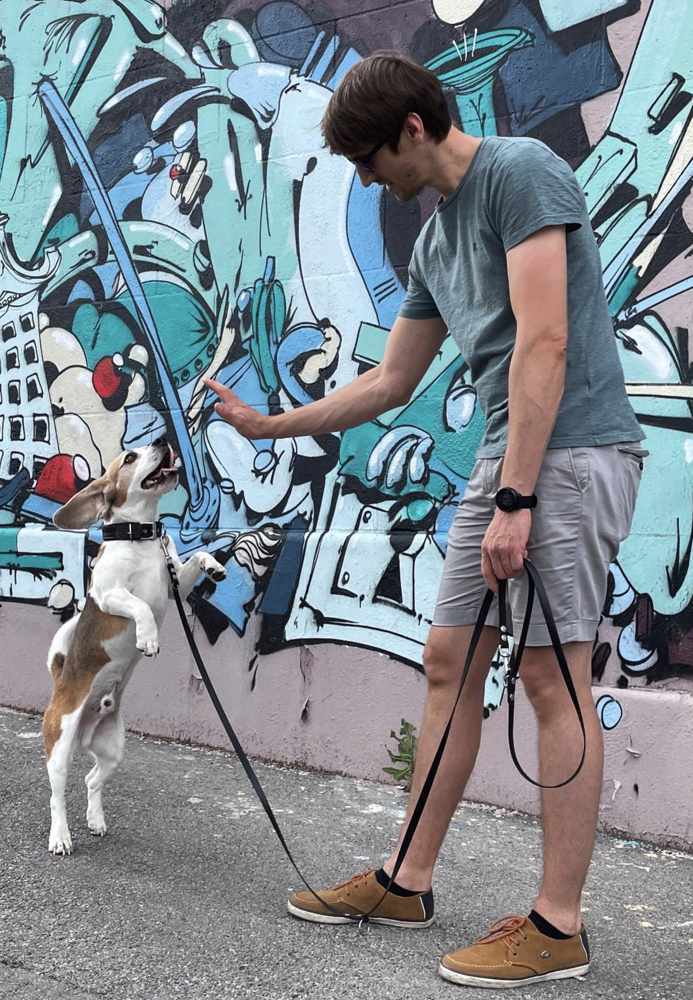

3input_image.png
Input:
Buffered data was truncated after reaching the output size limit.

In [ ]:
img_bboxes = []
img_cropped = []

for key in new_keys:
  input_img = key
  print(input_img)

  # YOLO detection
  a = !python yolov2_detection.py $input_img
  from IPython.display import Image,display
  print('Input:')
  display(Image(input_img))
  output_img = "detect.input_image"+ext
  print('Output:')
  display(Image(output_img))

  # gathering bboxes
  print(a)
  bboxes = eval(a[-2])
  bboxes.sort()
  print(bboxes)

  # OPENING ORIGINAL IMAGE TO EXTRACT SIZES
  img2 = PIL.Image.open(input_img)
  size_x, size_y = img2.size

  # Border added to capture some image surroundings, ?% of the image size
  # This allows to better merge the bboxes close-by
  percentage = 0.03
  for item in bboxes:
    if item[0] - size_x*percentage >= 0:
      item[0] = int(item[0] - size_x*percentage)
    if item[1] - size_y*percentage >= 0:
      item[1] = int(item[1] - size_y*percentage)
    if item[2] + size_x*percentage <= size_x:
      item[2] = item[2] + size_x*percentage
    if item[3] + size_y*percentage <= size_y:
      item[3] = int(item[3] + size_y*percentage)

  print(bboxes)

  # GROUPING BBOXES
  #first coords
  x0 = bboxes[0][0]
  x1 = bboxes[0][2]

  # bboxes per scene
  num_per_scene = []
  num = 0

  for i in range(len(bboxes)):
    if bboxes[i][0] > x1:
      x0 = bboxes[i][0]
      x1 = bboxes[i][2]
      num_per_scene.append(num)
      num = 1
      if i == len(bboxes)-1:
        num_per_scene.append(num)
    
    else:
      num += 1
      if x1 < bboxes[i][2]:
        x1 = bboxes[i][2]

  # in case there is only one scene the num_per_scene is the length of the list 
  if len(num_per_scene) == 0:
    num_per_scene = [len(bboxes)]
    x0 = min([i[0] for i in bboxes])
    x1 = max([i[2] for i in bboxes])
  
  # GETTING SCENE COORDINATES
  # transposing bboxes list (find smarter way) to get then corner coords
  bboxes_transp = list(map(list, zip(*bboxes)))

  bboxes_t_split_array = []
  for item in bboxes_transp:
    sp = np.split(item, np.cumsum(num_per_scene[:len(num_per_scene)-1]))
    bboxes_t_split_array.append(sp)
  
  print(bboxes_t_split_array)

  bboxes_t_split =  []
  for i in bboxes_t_split_array:
    scene = []
    for n in i:
      n = n.tolist()
      scene.append(n)
    bboxes_t_split.append(scene)
  
  print(bboxes_t_split)


  bboxes_scenes_group = list(map(list, zip(*bboxes_t_split)))

  bboxes_scenes = []
  for item in bboxes_scenes_group:
    x0 = min(item[0])
    y0 = min(item[1])
    x1 = max(item[2])
    y1 = max(item[3])
    bboxes_scenes.append([x0, y0, x1, y1])

  img_bboxes.append(bboxes_scenes)


  # CROPPING IMAGES
  cropped_scenes = []
  for i in range(len(bboxes_scenes)):
    img2_crop = img2.crop(bboxes_scenes[i])
    label = os.path.splitext(key)[0] + '_scene' + str(i)  + os.path.splitext(key)[-1]
    path = '/content.gdrive/MyDrive/Colab Notebooks/YOLO_testset/test/'
    img2_crop.save(path + label)
    display(img2_crop)
    cropped_scenes.append(img2_crop)
  
  img_cropped.append(cropped_scenes)
